In [3]:
import numpy as np
import matplotlib.pyplot as plt
import math

This notebook is to see the convergence criterium on one environnement. The first conjecture is E[X] = 1

E[X] = 1, we take h so that ||h|| = 1 and an increasing sequence alpha

In [37]:
# Paramètres de l'environnement de simulation :
n = 10000
Lambda_init = 1
Tmax = 1000
burn = 100
dt = (Tmax+burn)/n
mu = 1
theta = 0.7
sigma = 0.5
X_0 = 2
poiss = np.unique(np.concatenate((np.arange(0.3, 0.81, 0.1), np.arange(0.8, 1.05, 0.01))))
#poiss = np.unique(np.arange(0.7, 1.15, 0.05))
n_env = 1000

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


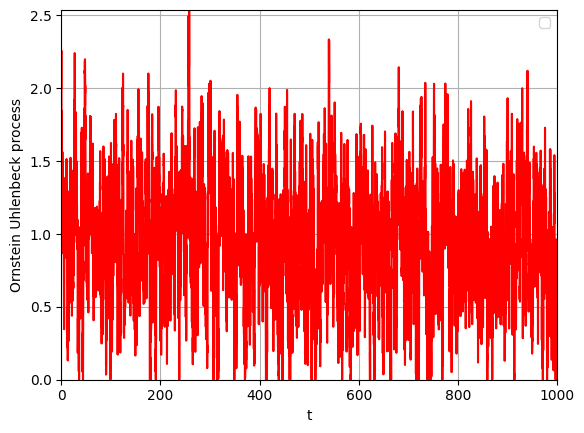

In [20]:
def rand_env(n, dt, mu, theta, sigma, X_0):
    X = np.zeros(n+1)
    X[0] = X_0
    for i in range(1,n+1):
        X[i] = X[i-1] + theta*(mu - X[i-1])*dt + sigma*np.random.normal(0,math.sqrt(dt))
        if X[i] < 0:
            X[i] = 0
    return X
X = rand_env(n, dt, mu, theta, sigma, X_0)
plot = plt.plot(np.linspace(0, Tmax, len(X)),X, color='red')
plt.xlim(0,Tmax)
plt.ylim(0,max(X))
plt.xlabel('t')
plt.ylabel('Ornstein Uhlenbeck process')
plt.legend()
plt.grid(True)

In [21]:
#remove the values of X between 0 and 10
X = X[burn:]

def critere(X, dt, Tmax):
    #define a vector taking values of exp(-t) between 0 and Tmax
    t = np.linspace(-Tmax, 0, len(X))
    exp_t = np.exp(t)
    return sum(X*exp_t)*dt
I = critere(X, dt, Tmax)

In [77]:
#MC method to estimate the expectation of the logarithm of the criterion, approx 2 min

def MC(n_MC, n, dt, mu, theta, sigma, X_0, Tmax, burn):
    crit = 0
    crit_log = 0
    for i in range(n_MC):
        X = rand_env(n, dt, mu, theta, sigma, X_0)
        X = X[burn:]
        crit += sum([math.log(i)for i in X if i > 0] )/n
        crit_log += math.log(critere(X, dt, Tmax))
    return [crit/n_MC, crit_log/n_MC]

val = MC(5000, n, dt, mu, theta, sigma, X_0, Tmax, burn)
val

[-0.10242881696365903, 0.09262237855450998]

In [78]:
esp = [val[0] + math.log(i)  for i in poiss]
log_crit = [val[1] + math.log(i) for i in poiss]

In [41]:
# We define a function that returns the environment for a given time t using linear interpolation

def env(X,t):
    return X[int(t/dt)] + (X[int(t/dt)+1] - X[int(t/dt)])*(t/dt - int(t/dt))

In [42]:
def hawkes_process(Lambda_init, Tmax, norm, X):
    immigrants = 1
    hawkes = np.array([0])
    print("Nombre d'immigrants : " + str(immigrants))
    times = hawkes
    i = 1
    #time_steps = np.linspace(0, Tmax -10, 11)
    step = 20

    while len(times) != 0:
        # print("norm : " + str(norm))
        # We first get the number of childs for each individual
        num_childs = [np.random.poisson((norm)*env(X, root)) for root in times]
        # print("Nombre d'individus de la génération " + str(i) + " : " + str(len(times)))
        # end condition
        if(num_childs == [0]*len(times)):
            break
        
        # We remove individuals without childs
        times = [times[i] for i in range(len(times)) if num_childs[i] > 0]
        num_childs = [num_childs[i] for i in range(len(num_childs)) if num_childs[i] > 0]
        
        # We then create the next generation time vector
        next_gen_times = []
        for j in range(len(times)):
            for _ in range(num_childs[j]):
                next_gen_times.append(times[j] + np.random.exponential(norm))
        


        times = [val for val in next_gen_times if val < Tmax]
        
        # We finally update the Hawkes vector 
        hawkes = np.append(hawkes, times) 
        
        if len(hawkes) > 1e6:
            print("stop the count, size = " + str(len(hawkes)))
            return 0
    
    return 1

In [64]:
n_iter = 10
n_env = 1000
non_explo = np.zeros(len(poiss))
perc = 0
for k in range(n_env):
    hawkes_list = [[0] * n_iter for _ in range(len(poiss))]
    X = rand_env(n, dt, mu, theta, sigma, X_0)
    X = X[burn:]
    for i in range(len(poiss)):
        for j in range(n_iter):
            perc += 1
            hawkes_result = hawkes_process(Lambda_init, Tmax, poiss[i], X)
            hawkes_list[i][j] = hawkes_result
            print("Iteration " + str(perc/(n_env*n_iter*len(poiss))*100) + "% done, critere = "+ str(val[1] + math.log(poiss[i])))
    non_explo = [non_explo[i] + sum(hawkes_list[i])/len(hawkes_list[i]) for i in range(len(poiss))]

Nombre d'immigrants : 1
Iteration 0.0003225806451612903% done, critere = -1.1124958061020864
Nombre d'immigrants : 1
Iteration 0.0006451612903225806% done, critere = -1.1124958061020864
Nombre d'immigrants : 1
Iteration 0.0009677419354838711% done, critere = -1.1124958061020864
Nombre d'immigrants : 1
Iteration 0.0012903225806451613% done, critere = -1.1124958061020864
Nombre d'immigrants : 1
Iteration 0.0016129032258064516% done, critere = -1.1124958061020864
Nombre d'immigrants : 1
Iteration 0.0019354838709677422% done, critere = -1.1124958061020864
Nombre d'immigrants : 1
Iteration 0.002258064516129032% done, critere = -1.1124958061020864
Nombre d'immigrants : 1
Iteration 0.0025806451612903226% done, critere = -1.1124958061020864
Nombre d'immigrants : 1
Iteration 0.002903225806451613% done, critere = -1.1124958061020864
Nombre d'immigrants : 1
Iteration 0.0032258064516129032% done, critere = -1.1124958061020864
Nombre d'immigrants : 1
Iteration 0.0035483870967741938% done, critere =

In [65]:
crit = [math.log(max(i,0.01))+val[1] for i in poiss]

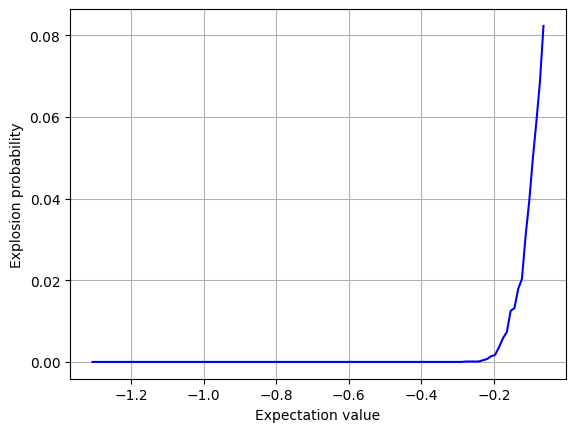

In [79]:
plt.figure()
plt.plot(esp, 1- np.array(non_explo)/n_env, color='blue')
plt.xlabel('Expectation value')
plt.ylabel('Explosion probability')
plt.grid(True)
plt.savefig('img/explo_prb_esp.png')
plt.show()

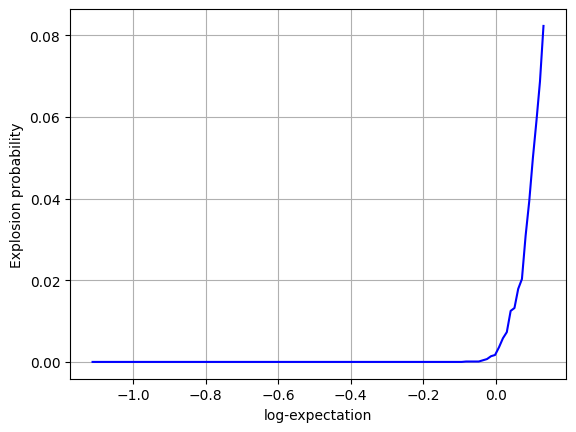

In [80]:
plt.figure()
plt.plot(log_crit,1 -  np.array(non_explo)/n_env, color='blue')
plt.xlabel('log-expectation')
plt.ylabel('Explosion probability')
plt.grid(True)
plt.savefig('img/explo_prb_log.png')
plt.show()

In [ ]:
def hawkes_process(Lambda_init, Tmax, norm, X):
    immigrants = np.random.poisson(Lambda_init * Tmax)
    hawkes = np.sort(np.random.uniform(0, Tmax, immigrants))
    #print("Nombre d'immigrants : " + str(immigrants))
    times = hawkes
    i = 1
    #time_steps = np.linspace(0, Tmax -10, 11)
    #step = 20
    print("norm : " + str(norm) )
    while len(times) != 0 :
        # print("pop : " + str(len(hawkes)))
        # We first get the number of childs for each individual
        num_childs = [np.random.poisson((norm)*env(X, root)) for root in times]
        # print("Nombre d'individus de la génération " + str(i) + " : " + str(len(times)))
        # end condition
        if(num_childs == [0]*len(times)):
            break
        
        # We remove individuals without childs
        times = [times[i] for i in range(len(times)) if num_childs[i] > 0]
        num_childs = [num_childs[i] for i in range(len(num_childs)) if num_childs[i] > 0]
        
        # We then create the next generation time vector
        next_gen_times = []
        for j in range(len(times)):
            for _ in range(num_childs[j]):
                next_gen_times.append(times[j] + np.random.exponential(norm))

        times = [val for val in next_gen_times if val < Tmax]
        
        # We finally update the Hawkes vector 
        hawkes = np.append(hawkes, times)
        if len(hawkes) > 1e6:
            print("stop the count, size = " + str(len(hawkes)))
            return np.sort(hawkes)
        i = i+1
    return np.sort(hawkes)

In [ ]:
n_iter = 50
n_env = 10
non_explo = np.zeros(len(poiss))
perc = 0
hawkes_list = [[[[] for _ in range(n_iter)] for _ in range(len(poiss))] for _ in range(n_env)]
for k in range(n_env):
    X = rand_env(n, dt, mu, theta, sigma, X_0)
    X = X[burn:]
    for j in range(n_iter):
        for i in range(len(poiss)):
            perc += 1
            hawkes_result = hawkes_process(Lambda_init, Tmax, poiss[i], X)
            hawkes_list[k][i][j] = hawkes_result
            print("Iteration " + str(perc/(n_env*n_iter*len(poiss))*100) + "% done, last pop size = "+str(len(hawkes_list[k][i][j]))  )

list_min = min([max(hawkes[j]) for j in range(n_iter)])
